## Josh's example 

In [ ]:
Test

## Step 0: run libraries

In [1]:
library(tidyverse)
library(repr)
library(tidymodels)
options(repr.matrix.max.rows = 6)
source("cleanup.R") 

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.1     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
── Attaching packages ────────────────────────────────────── tidymodels 1.1.1 ──

✔ broom        1.0.6     ✔ rsample      1.2.1
✔ dials        1.3.0     ✔ tune         1.1.2
✔ infer        1.0.7     ✔ workflows    1.1.4
✔ modeldata    1.4.0     ✔ workflowsets 1.0.1
✔ parsnip      1.2.1     ✔ yardstick    1.3.1
✔ recipes      1.1.0     

── Conflicts ───────────────────────────────────────── tidymodels_conflicts() ──
✖ scales::discard() masks purrr::discard()
✖ dplyr::filt

## Step 1: Get data from fruit data set

In [3]:
data <- read_csv("data/fruit_data.csv")
data

Rows: 59 Columns: 7
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr (2): fruit_name, fruit_subtype
dbl (5): fruit_label, mass, width, height, color_score

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


fruit_label,fruit_name,fruit_subtype,mass,width,height,color_score
<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
1,apple,granny_smith,192,8.4,7.3,0.55
1,apple,granny_smith,180,8.0,6.8,0.59
1,apple,granny_smith,176,7.4,7.2,0.60
⋮,⋮,⋮,⋮,⋮,⋮,⋮
4,lemon,unknown,116,5.9,8.1,0.73
4,lemon,unknown,152,6.5,8.5,0.72
4,lemon,unknown,118,6.1,8.1,0.70


## Step 2: select the class variable(1) and explanatory variables(2+)

**Ensure there is only two possibilites for the class variable**
- In this case just apples or lemons

In [4]:
selected_fruits <- data |>
    select(fruit_name, mass, width) |>
    filter(fruit_name == "apple" | fruit_name == "lemon")
selected_fruits

fruit_name,mass,width
<chr>,<dbl>,<dbl>
apple,192,8.4
apple,180,8.0
apple,176,7.4
⋮,⋮,⋮
lemon,116,5.9
lemon,152,6.5
lemon,118,6.1


## Step 3: Look at data and ensure cols are right class
**you want the class to be a factor(fct) and the explanatory variabiles to be a double(dbl)** 

In [5]:
print(selected_fruits)

# A tibble: 35 × 3
   fruit_name  mass width
   <chr>      <dbl> <dbl>
 1 apple        192   8.4
 2 apple        180   8  
 3 apple        176   7.4
 4 apple        178   7.1
 5 apple        172   7.4
 6 apple        166   6.9
 7 apple        172   7.1
 8 apple        154   7  
 9 apple        164   7.3
10 apple        152   7.6
# ℹ 25 more rows


**check out what it looks like!**
- Notice how it isnt scaled, e.g. vizuale scale ≠ actual 

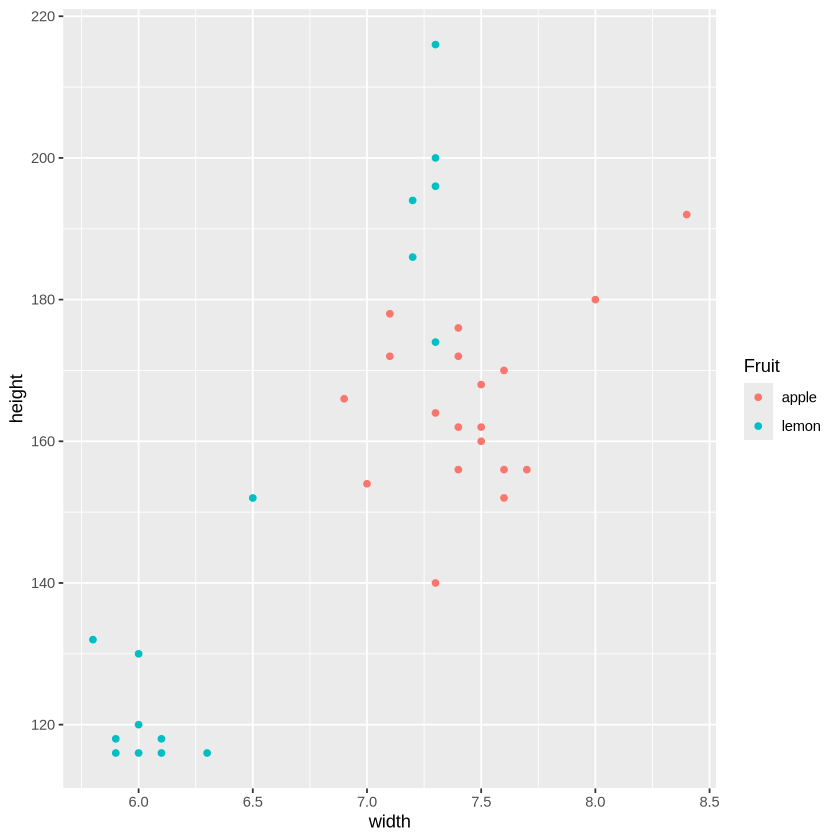

In [6]:
selected_fruits_graph <- selected_fruits |>
    ggplot(aes(x = width, y = mass, colour = fruit_name)) +
    geom_point() +
    labs(x = "width",
         y = "height",
         colour = "Fruit")
    
selected_fruits_graph

## Step 4: Rename outcome to class, make class a factor and encode
- Sometimes explanatory variable is called predictor

In [7]:
factor_fruits <- selected_fruits |>
    mutate(Class = as_factor(fruit_name)) |>
    mutate(Class = fct_recode(Class, "a" = "apple" , "l" = "lemon")) |>
    select(Class, mass, width)
factor_fruits

Class,mass,width
<fct>,<dbl>,<dbl>
a,192,8.4
a,180,8.0
a,176,7.4
⋮,⋮,⋮
l,116,5.9
l,152,6.5
l,118,6.1


## Step 5: Standardize = scale + centers
- Make a recipe that scales and centers the df

In [18]:
standard_fruit <- recipe(Class ~ ., data = factor_fruits) |>
    step_center(all_predictors()) |>
    step_scale(all_predictors())|>
    prep()
standard_fruit



── Recipe ──────────────────────────────────────────────────────────────────────



── Inputs 

Number of variables by role

outcome:   1
predictor: 2



── Training information 

Training data contained 35 data points and no incomplete rows.



── Operations 

• Centering for: mass and width | Trained

• Scaling for: mass and width | Trained



**check out the new graph!**

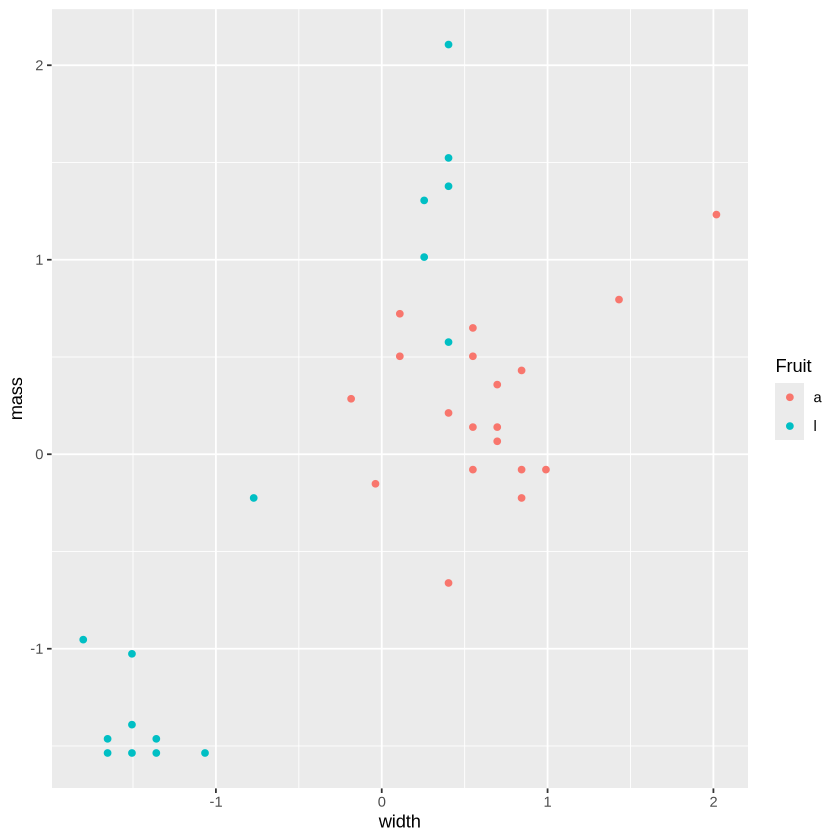

In [19]:
visual_standard <- bake(standard_fruit, factor_fruits)

stadard_fruits_graph <- visual_standard |>
    ggplot(aes(x = width, y = mass, colour = Class)) +
    geom_point() +
    labs(x = "width",
         y = "mass",
         colour = "Fruit")
    
stadard_fruits_graph

In [102]:
sum(visual_recipe_standard$mass > 0)
sum(visual_recipe_standard$mass < 0)

[1] 19

[1] 16

In [103]:
sum(visual_recipe_standard$width > 0)
sum(visual_recipe_standard$width < 0)

[1] 23

[1] 12

## Step 5.1 (optional) What if the data is unbalenced? ##

- cnt of class_a = 400
- cnt of class_b = 40

**Say we only take 3 of our apples**
- then we need to extrapolate/overweigh that data
- it needs to be "punching up"

In [117]:
library(dplyr)

##Fake the data##
faked_fruit <- visual_recipe_standard |>
  filter(Class == "a") |>
  mutate(.sum = width + mass) |>
  arrange(desc(.sum)) |>
  slice_head(n = 3) |>
  select(-.sum) |>
  bind_rows(
    visual_recipe_standard |> filter(Class == "l")
  )
result
# count(result)

mass,width,Class
<dbl>,<dbl>,<fct>
1.2321809,2.0181058,a
0.7950897,1.4307153,a
0.4308470,0.8433249,a
⋮,⋮,⋮
-1.5360634,-1.6530846,l
-0.2247898,-0.7719989,l
-1.4632148,-1.3593893,l


**here is what the graph looks like**

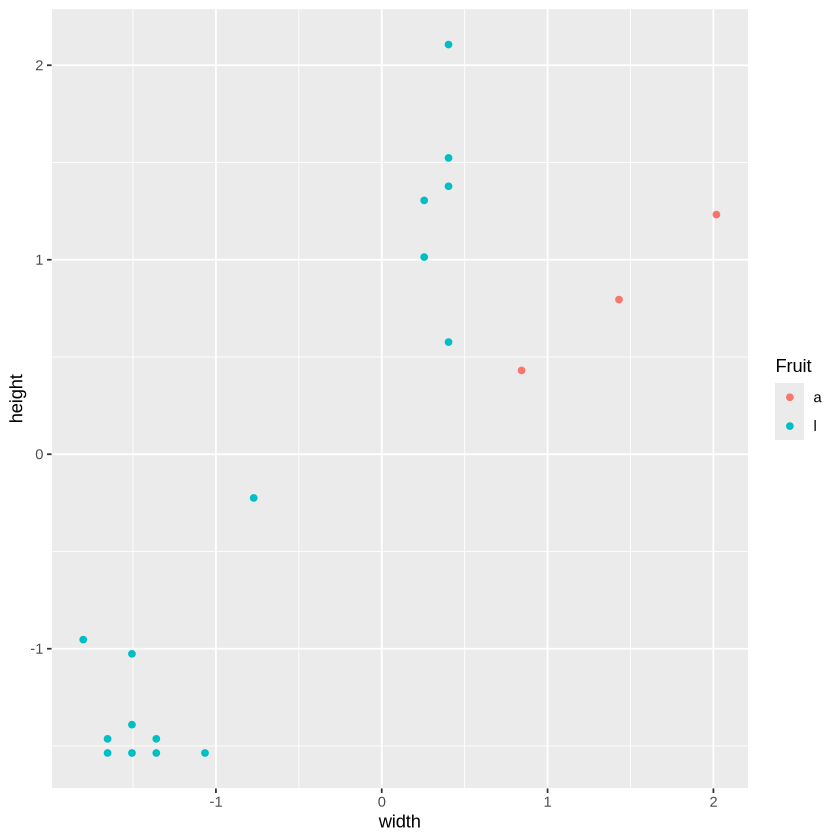

In [144]:
faked_fruit_graph <- faked_fruit |>
    ggplot(aes(x = width, y = mass, colour = Class)) +
    geom_point() +
    labs(x = "width",
         y = "height",
         colour = "Fruit")
    
faked_fruit_graph

**and here is the not so good predition grid**

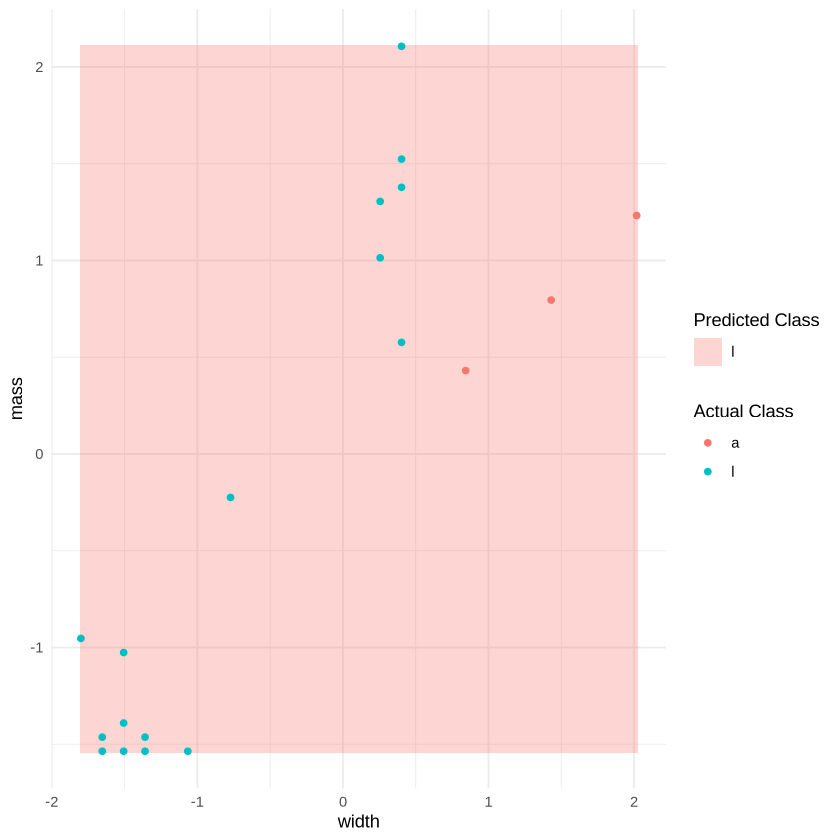

In [145]:
library(tidymodels)
library(ggplot2)

# Step 1: Normalize and prepare data
fruit_rec_faked <- recipe(Class ~ width + mass, data = faked_fruit) |>
  step_normalize(all_predictors())

# Step 2: Model spec
knn_spec_faked <- nearest_neighbor(neighbors = 7, weight_func = "rectangular") |>
  set_engine("kknn") |>
  set_mode("classification")

# Step 3: Workflow and fit
fruit_workflow_faked <- workflow() |>
  add_recipe(fruit_rec_faked) |>
  add_model(knn_spec_faked)

fruit_fit_faked <- fit(fruit_workflow_faked, data = faked_fruit)

# Step 4: Prediction grid for background
grid_vals_faked <- expand.grid(
  width = seq(min(faked_fruit$width), max(faked_fruit$width), length.out = 200),
  mass  = seq(min(faked_fruit$mass),  max(faked_fruit$mass),  length.out = 200)
)

# Step 5: Predict grid classes
grid_pred_faked <- predict(fruit_fit_faked, new_data = grid_vals_faked)

# Combine with grid for plotting
grid_vals_faked$Class <- grid_pred_faked$.pred_class

# Step 6: Plot
ggplot() +
  geom_tile(data = grid_vals_faked, aes(x = width, y = mass, fill = Class), alpha = 0.3) +
  geom_point(data = faked_fruit, aes(x = width, y = mass, color = Class)) +
  labs(x = "width", y = "mass", fill = "Predicted Class", color = "Actual Class") +
  theme_minimal()

**Make the game fair by upsampling**

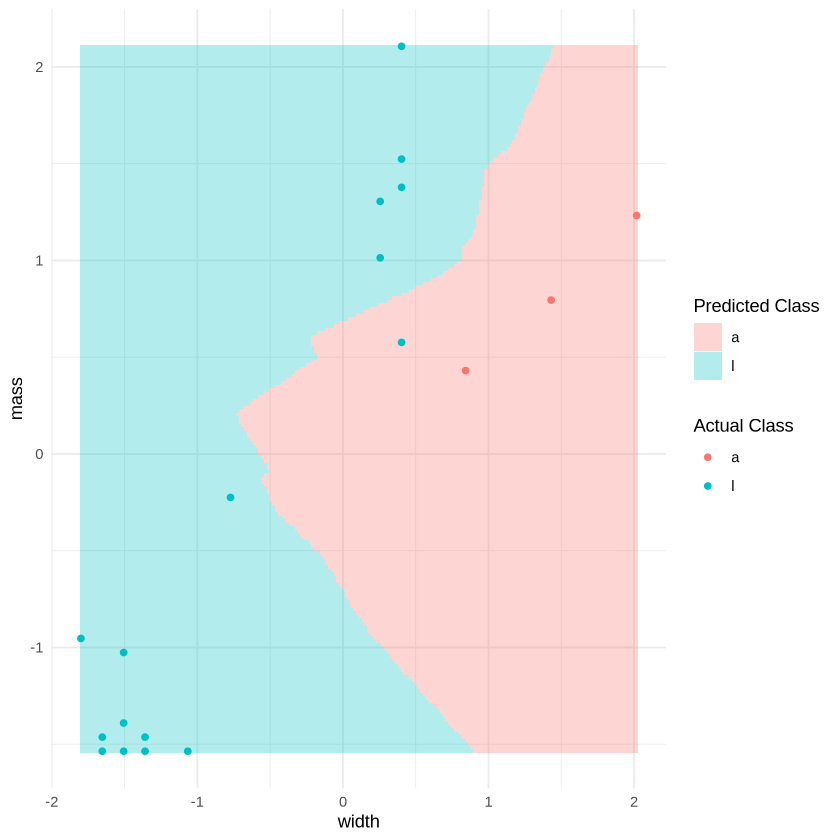

In [147]:
library(tidymodels)
library(themis)
library(ggplot2)

# Step 1: Preprocessing recipe (normalize + upsample during training only)
fruit_rec_balanced <- recipe(Class ~ width + mass, data = faked_fruit) |>
  step_normalize(all_predictors()) |>
  step_upsample(Class, over_ratio = 1, skip = TRUE)

# Step 2: KNN model specification
knn_spec_balanced <- nearest_neighbor(neighbors = 7, weight_func = "rectangular") |>
  set_engine("kknn") |>
  set_mode("classification")

# Step 3: Workflow (recipe + model)
fruit_workflow_balanced <- workflow() |>
  add_recipe(fruit_rec_balanced) |>
  add_model(knn_spec_balanced)

# Step 4: Fit model on training data
fruit_fit_balanced <- fit(fruit_workflow_balanced, data = faked_fruit)

# Step 5: Generate prediction grid
grid_vals_balanced <- expand.grid(
  width = seq(min(faked_fruit$width), max(faked_fruit$width), length.out = 200),
  mass  = seq(min(faked_fruit$mass),  max(faked_fruit$mass),  length.out = 200)
)

# Step 6: Predict class labels on the grid
grid_pred_balanced <- predict(fruit_fit_balanced, new_data = grid_vals_balanced)
grid_vals_balanced$Class <- grid_pred_balanced$.pred_class

# Step 7: Plot decision regions and original data points
fruit_plot_balanced <- ggplot() +
  geom_tile(data = grid_vals_balanced, aes(x = width, y = mass, fill = Class), alpha = 0.3) +
  geom_point(data = faked_fruit, aes(x = width, y = mass, color = Class)) +
  labs(
    x = "width",
    y = "mass",
    fill = "Predicted Class",
    color = "Actual Class"
  ) +
  theme_minimal()

# Display the plot
fruit_plot_balanced

## Step 6: Add the neighbour search ##

**Chose the engine and mode**

In [13]:
# create the K-NN model
knn_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = 7) |>
  set_engine("kknn") |>
  set_mode("classification")

**Fit the data using the spec**

In [15]:
knn_fit <- fit(knn_spec, Class ~ ., data = factor_fruits)
knn_fit

parsnip model object


Call:
kknn::train.kknn(formula = Class ~ ., data = data, ks = min_rows(7,     data, 5), kernel = ~"rectangular")

Type of response variable: nominal
Minimal misclassification: 0.05714286
Best kernel: rectangular
Best k: 7

## Step 7: Classify a new data point ##

In [16]:
new_observation <- tibble(width = 1, mass = 1)
prediction <- predict(knn_fit, new_observation)
prediction

.pred_class
<fct>
l


## Step 8: Make it all into one! ##

In [22]:
# ?recipe

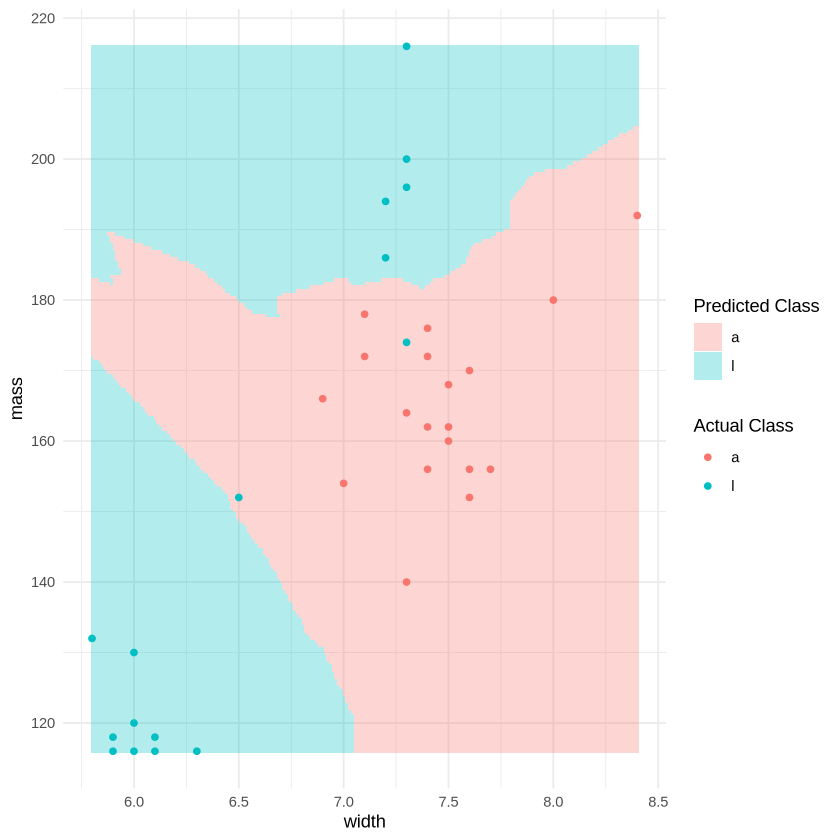

In [20]:
library(tidymodels)
library(ggplot2)

# Step 1: Create recipe with scaling + centering
fruit_recipe <- recipe(Class ~ mass + width, data = factor_fruits) |>
    step_scale(all_predictors()) |>
    step_center(all_predictors())


# Step 2: Define KNN model
knn_spec <- nearest_neighbor(neighbors = 7, weight_func = "rectangular") |>
  set_engine("kknn") |>
  set_mode("classification")

# Step 3: Create workflow and fit model
fruit_workflow <- workflow() |>
  add_recipe(fruit_recipe) |>
  add_model(knn_spec)

fruit_fit <- fit(fruit_workflow, data = factor_fruits)

# Step 4: Create prediction grid
grid_vals <- expand.grid(
  width = seq(min(factor_fruits$width), max(factor_fruits$width), length.out = 200),
  mass  = seq(min(factor_fruits$mass),  max(factor_fruits$mass),  length.out = 200)
)

# Step 5: Predict on grid
grid_pred <- predict(fruit_fit, new_data = grid_vals)
grid_vals$Class <- grid_pred$.pred_class

# Step 6: Plot decision regions
fruit_plot <- ggplot() +
  geom_tile(data = grid_vals, aes(x = width, y = mass, fill = Class), alpha = 0.3) +
  geom_point(data = factor_fruits, aes(x = width, y = mass, color = Class)) +
  labs(x = "width", y = "mass", fill = "Predicted Class", color = "Actual Class") +
  theme_minimal()

fruit_plot